***
created by Farah Rabie (fr2007@hw.ac.uk)
***

<p>In this notebook, we explore how to apply <em>KMeans clustering</em>, an unsupervised Machine Learning algorithm, to well log data. The goal is to group similar sections of well log data, allowing us to uncover patterns or clusters that may correlate with different lithologies. We will follow these steps:</p>
<ul>
    <li><em>Processing the Data</em> – Cleaning and standardising the well log data.</li>
    <li><em>KMeans Clustering</em> – Applying the KMeans algorithm to categorise the well data into meaningful clusters.</li>
    <li><em>Visualising the Results</em> – Visualising the clusters and comparing them with true lithology.</li>
</ul>

<p>By the end of this notebook, we will have a clear view of how KMeans can be used to classify well log data.



Below are the video tutorials on data processing and KMeans Clustering. [Link to Tutorial 1](https://github.com/T0mahawkk/GeosciencePlusAI/blob/main/Video%20Tutorials/Tutorial-2-_KMeans-Clustering_Video-1.mp4) and The [Link to Tutorial 2](https://github.com/T0mahawkk/GeosciencePlusAI/blob/main/Video%20Tutorials/Tutorial_2_KMeans-Clustering_Video-2.mp4).</p>

In [7]:
from IPython.display import Video

Data_Processing = "../Video Tutorials/Tutorial_2_KMeans-Clustering_Video-1.mp4"
Video(Data_Processing, embed=True, width=800, height=450)

In [8]:
KMeans_Clustering = "../Video Tutorials/Tutorial_2_KMeans-Clustering_Video-2.mp4"
Video(KMeans_Clustering, embed=True, width=800, height=450)

## <font color='Orange'>Data Processing for Clustering</font>

<p>We start off with processing the well log data. The <code>DataProcessing</code> class is imported from the <code>Lib.ClusteringFunctions</code> module and instantiated as <code>DataProcess.</code> This allows us to access its methods for processing, scaling, and visualising well data.</p> 

In [10]:
from ClusteringFunctions import DataProcessing
DataProcess = DataProcessing()

<p>The <code>process_well_data</code> method loads multiple well log datasets and performs various steps to clean the data, including handling missing values and applying logarithmic transformations to certain columns (specifically, KLOGH and RT). The <code>selected columns</code> for processing include key geophysical properties, with the LITHOLOGY column included for later use.</p>

<p>If <code>train_data</code> is set to <code>True</code>, the data is considered <strong><span style="color: blue;">training</span></strong> data. In this case, the data from all wells is combined into a single DataFrame, and scaling parameters are computed for the numerical columns, excluding the LITHOLOGY column. In this process, the descriptive statistics and the first few rows of the processed data can be displayed to give a snapshot of the cleaned data by setting <code>show_stats</code> and <code>show_rows</code> to <code>True,</code> respectively.</p>

In [22]:
import pandas as pd
train_well_data_path = [#r"..\Data\15_9-F-1 B.csv", 
                        r"..\Data\15_9-F-4.csv"]
                        #r"..\Data\15_9-F-5.csv",
                        #r"..\Data\15_9-F-11 B.csv",
                        #r"..\Data\15_9-F-12.csv"]

selected_columns_train = ['BVW', 'KLOGH', 'VSH', 'GR', 'NPHI', 'RHOB', 'RT'] # 'DT' and 'PEF' data were excluded

processed_train_well_data = DataProcess.process_well_data(train_well_data_path, selected_columns_train, train_data=True, show_stats=True, show_rows=False)


pd.set_option('display.max_columns', None)  # Display all columns
pd.set_option('display.width', 5000)  # Adjust the width to display the DataFrame within a reasonable width
pd.set_option('display.max_colwidth', None)  # Display full column width
#print(processed_train_well_data.head(10))


Descriptive Statistics of Data:
               BVW          VSH           GR         NPHI         RHOB    log_KLOGH       log_RT
count  2585.000000  2585.000000  2585.000000  2585.000000  2585.000000  2585.000000  2585.000000
mean      0.082783     0.378572    69.434706     0.232420     2.365990     2.572322     1.943649
std       0.090658     0.247979    54.812939     0.093245     0.172536     3.019666     1.253026
min       0.002900     0.048900    10.681200     0.055700     1.334100     0.000300     0.392718
25%       0.037300     0.168000    29.383600     0.171200     2.229900     0.001000     1.037658
50%       0.076000     0.274800    46.145699     0.216800     2.380200     0.281563     1.353900
75%       0.114000     0.630500   101.984398     0.269900     2.490200     5.392466     2.783516
max       1.000000     0.799800   469.738007     0.732400     3.201300     8.941177     8.517393


<p>When <code>train_data</code> is set to <code>False</code>, the data is considered <strong><span style="color: blue;">testing</span></strong> data. In that case, the data for each well is kept separate in individual DataFrames, allowing for independent testing.</p>

In [25]:
selected_columns_test = ['DEPTH', 'BVW', 'KLOGH', 'VSH', 'GR', 'NPHI', 'RHOB', 'RT', 'LITHOLOGY'] # 'DT' and 'PEF' data were excluded

test_well_data_path = [r"..\Data\15_9-F-5.csv"] #r"..\Data\15_9-F-15 C.csv"]
processed_test_well_data = DataProcess.process_well_data(test_well_data_path, selected_columns_test, train_data=False, show_stats=False, show_rows=False)

<p> <em>Scaling</em> is essential for ensuring that all numerical features in the dataset are on a similar scale, preventing any single feature from dominating the model due to differences in range. The processed training well data is standardised using the <code>standardise_dataframe</code> method from the <code>DataProcess</code> instance. This method scales the numerical features in the data based on the previously computed scaling parameters, excluding the LITHOLOGY column. The standardisation process also displays descriptive statistics of the standardised data if the <code>show_stats</code> parameter is set to <code>True</code>.</p>

<p>First, we standardise the training data.</p>

In [26]:
standardised_train_well_data = DataProcess.standardise_dataframe(processed_train_well_data, show_stats=True)

Standardisation Parameters:
BVW: mean = 0.08278324949361703, std = 0.09065809128644776
VSH: mean = 0.3785723020193424, std = 0.24797909450215727
GR: mean = 69.43470648565959, std = 54.81293887742902
NPHI: mean = 0.23241996136750487, std = 0.09324490433217393
RHOB: mean = 2.365989554647969, std = 0.17253555927009565
log_KLOGH: mean = 2.57232225739572, std = 3.0196662840368074
log_RT: mean = 1.9436489369863843, std = 1.2530261297421401

Descriptive Statistics of Standardised Data:
                BVW           VSH            GR          NPHI          RHOB    log_KLOGH        log_RT
count  2.585000e+03  2.585000e+03  2.585000e+03  2.585000e+03  2.585000e+03  2585.000000  2.585000e+03
mean  -3.298458e-17 -1.319383e-16 -2.198972e-16 -3.078560e-16  1.517290e-15     0.000000  1.319383e-16
std    1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00  1.000000e+00     1.000000  1.000000e+00
min   -8.811486e-01 -1.329436e+00 -1.071891e+00 -1.895224e+00 -5.980736e+00    -0.851757 -1.237749e+00
2

<br>Next, we standardise the testing data. 

In [27]:
standardised_test_well_data = [] # each well has its data stored in a separate DataFrame
for df in processed_test_well_data:
    standardised_df = DataProcess.standardise_dataframe(df, show_stats=True)
    standardised_test_well_data.append(standardised_df)

Standardisation Parameters:
BVW: mean = 0.08278324949361703, std = 0.09065809128644776
VSH: mean = 0.3785723020193424, std = 0.24797909450215727
GR: mean = 69.43470648565959, std = 54.81293887742902
NPHI: mean = 0.23241996136750487, std = 0.09324490433217393
RHOB: mean = 2.365989554647969, std = 0.17253555927009565
log_KLOGH: mean = 2.57232225739572, std = 3.0196662840368074
log_RT: mean = 1.9436489369863843, std = 1.2530261297421401

Descriptive Statistics of Standardised Data:
             DEPTH          BVW          VSH           GR         NPHI         RHOB    log_KLOGH       log_RT
count  3396.000000  3396.000000  3396.000000  3396.000000  3396.000000  3396.000000  3396.000000  3396.000000
mean   3507.569215    -0.214529     0.240884    -0.108022    -0.194912     0.297825    -0.247666     0.000563
std     149.426226     0.441537     1.097180     1.229123     0.801026     0.916093     0.789584     1.017924
min    3248.869698    -0.913137    -1.293949    -1.054581    -1.904876    -1

<br>
<p>To visualise and compare the distributions of a specific feature before and after standardisation, you can use the <code>compare_distributions</code> method. In this case, the <em>GR</em> feature is selected, and the method plots its distribution for both the processed data (<code>processed_train_well_data</code>) and the standardised data (<code>standardised_train_well_data</code>). This allows us to assess how standardisation has transformed the feature values, ensuring they follow a consistent scale while retaining the overall shape and characteristics of the original distribution.</p>

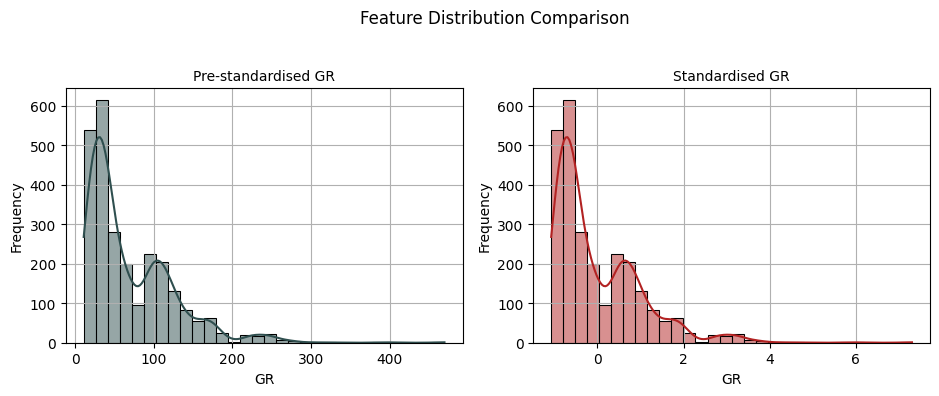

In [28]:
DataProcess.compare_distributions(processed_train_well_data, standardised_train_well_data, 'GR')
# Options: 'BVW', 'KLOGH', 'VSH', 'GR', 'NPHI', 'RHOB', 'RT'

## <font color='Orange'>Choosing the Optimal Number of Clusters (Elbow Method)</font>

<p>Next, we import the <code>KMeansClustering</code> class from the <code>ClusteringFunctions</code> module and create an instance of it, named <code>KMeans_Clustering</code>. This instance will be used to perform clustering tasks such as fitting the K-Means model, determining optimal cluster numbers, and analysing the results.</p>

In [31]:
from ClusteringFunctions import KMeansClustering
KMeans_Clustering = KMeansClustering()

<p>The <code>KMeans_Clustering.elbow_method</code> is used to determine the optimal number of clusters for the standardised training dataset (<code>standardised_train_well_data</code>). By varying the number of clusters (<code>k</code>) from 1 to 10, it calculates and plots the <em>inertia</em>, the sum of squared distances to the nearest cluster centroid. The resulting <em>elbow</em> plot helps identify the ideal number of clusters, where the inertia starts to decrease more slowly, indicating a balance between underfitting and overfitting.</p>

k: 1
inertia:  18088.000000000004
k: 2
inertia:  10239.697620214833
k: 3
inertia:  7026.824907539186
k: 4
inertia:  4502.036333197532
k: 5
inertia:  3503.6641970559645
k: 6
inertia:  2646.1042815878363
k: 7
inertia:  2359.3894654571673
k: 8
inertia:  2108.848951674898
k: 9
inertia:  1871.2068176129649
k: 10
inertia:  1708.7631391029734


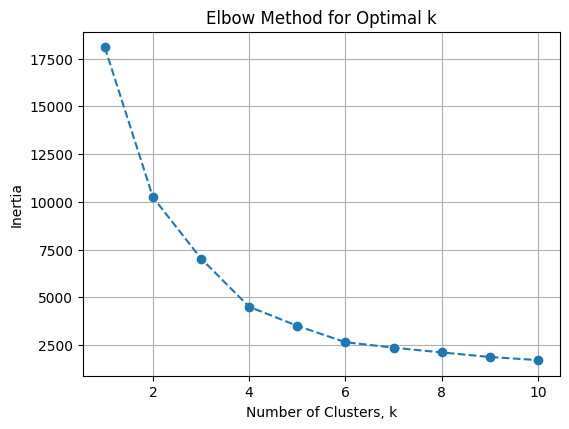

In [63]:
KMeans_Clustering.elbow_method(standardised_train_well_data, max_k=10)

## <font color='Orange'>Applying K-Means Clustering to Well Log Data</font>

<p>Now that we have standardised our well log data, we can proceed with applying the KMeans clustering algorithm. We will begin by training the model using the standardised training dataset. For this exercise, we specify the number of clusters, <code>n_clusters = 4</code>, based on our previous analysis of the elbow chart.</p>

<p>The <show_stats=True> option will provide us with useful performance metrics, such as the <em>inertia</em> and <em>silhouette score</em>, which help us assess the quality of our clustering.</p>

In [64]:
train_clustered, kmeans_model = KMeans_Clustering.run_kmeans_train(standardised_train_well_data, n_clusters=4, show_stats=True)

K-Means Clustering Results (Training Data) with 4 Clusters
Inertia (Sum of Squared Distances to Centroids): 4502.036333197531
Silhouette Score (Training Data): 0.4726


Next, we use the trained KMeans model to predict the clusters for the first well in our test dataset. This step involves applying the model we trained earlier to a new, unseen dataset, allowing us to evaluate how well the clustering generalises to other wells.

In [65]:
# train_well_data_path and selected_columns_test previously set
# train_data=False > even though this is training data, we want to process it as testing data so we can plot it

# for reference:
#standardised_train_singles_well_data
#"../Data/15_9-F-4.csv" >> 0

#standardised_test_well_data
#"../Data/15_9-F-5.csv" >> 0

processed_train_singles_well_data = DataProcess.process_well_data(train_well_data_path, selected_columns_test, train_data=False, show_stats=False, show_rows=False)

standardised_train_singles_well_data = [] # each well has its data stored in a separate DataFrame
for df in processed_train_singles_well_data:
    standardised_df = DataProcess.standardise_dataframe(df, show_stats=False)
    standardised_train_singles_well_data.append(standardised_df)

train_clustered_1 = KMeans_Clustering.run_kmeans_test(standardised_train_singles_well_data[0], kmeans_model)

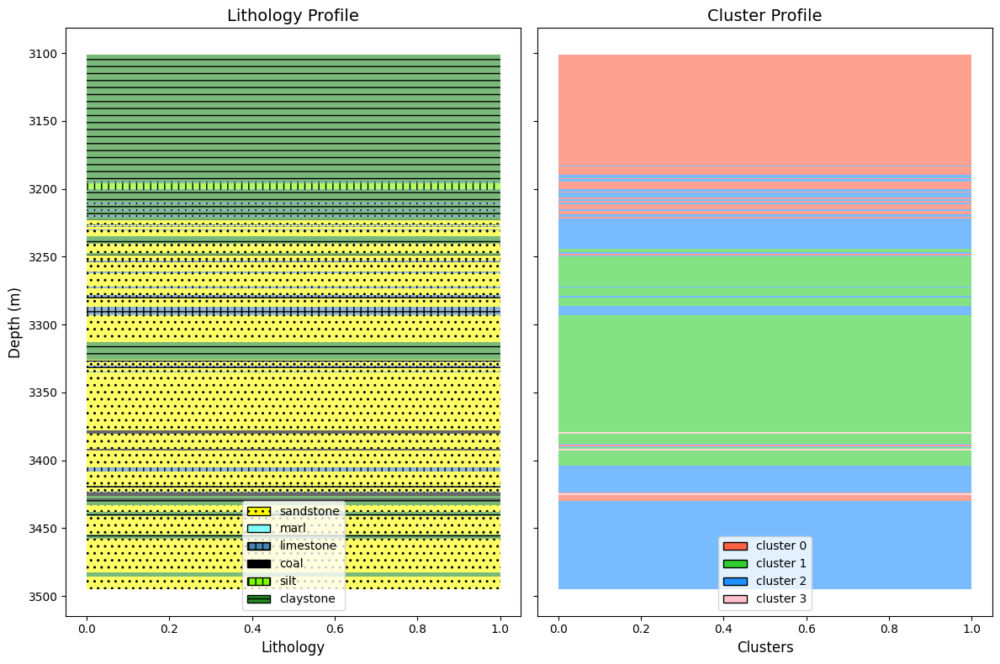

In [66]:
KMeans_Clustering.visualise_lithology_clusters(train_clustered_1)

Next, we use the trained KMeans model to predict the clusters for the first well in our test dataset. This step involves applying the model we trained earlier to a new, unseen dataset, allowing us to evaluate how well the clustering generalises to other wells.

In [67]:
test_clustered_1 = KMeans_Clustering.run_kmeans_test(standardised_test_well_data[0], kmeans_model)

Now that we have assigned clusters to the first test well, we can visualise the results. We’ll plot the clusters on a graph to see how well KMeans has identified the different lithologies in the well. This will create a visual representation of the clusters, making it easier to interpret the results and see how the KMeans algorithm has grouped the data.

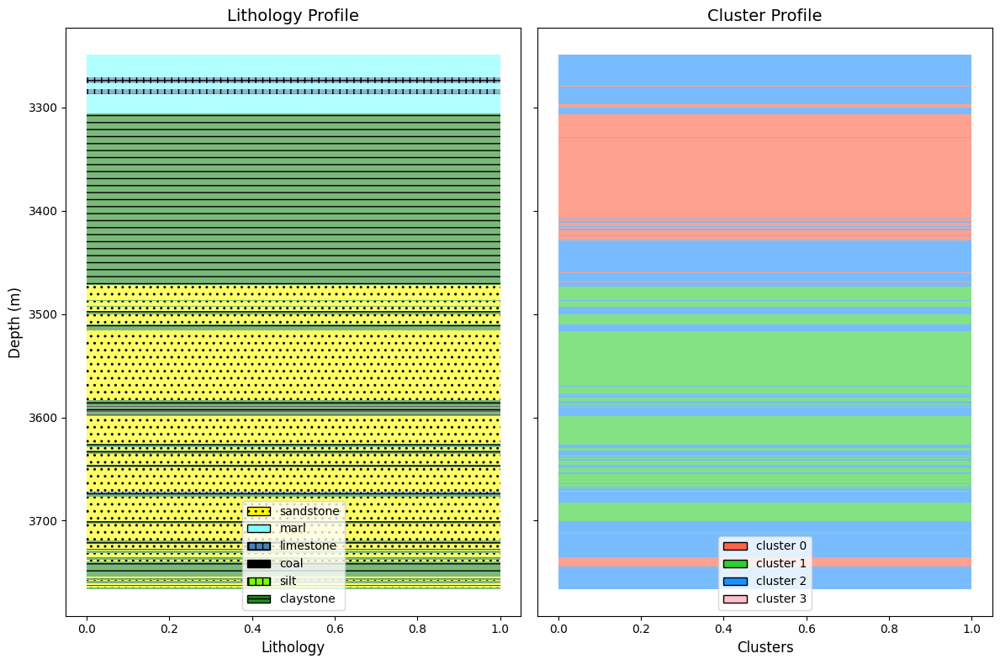

In [68]:
KMeans_Clustering.visualise_lithology_clusters(test_clustered_1)

We can repeat this for the second testing well.

In [71]:
test_clustered_2 = KMeans_Clustering.run_kmeans_test(standardised_test_well_data[1], kmeans_model)
KMeans_Clustering.visualise_lithology_clusters(test_clustered_2)

IndexError: list index out of range